# Homework 2 (100 Points)

The goal of this homework is to get more practice with clustering and SVD on various datasets.

## Exercise 1 - (50 points)

This exercise will be using the [AirBnB dataset](http://insideairbnb.com/get-the-data.html) for New York City called `listings.csv`. You should find this data in your downloaded repository. If not, it is a resource under Piazza.

a) Produce a [Marker Cluster](https://deparkes.co.uk/2016/06/24/folium-marker-clusters/) using the Folium and Selenium package (you can install them using pip) of the mean listing price per location (lattitude and longitude) over the New York City map. (5 points)

To start, generate a base map of New York City to plot over: (**`location=[40.693943, -73.985880], zoom_start = 11`**). Then, generate and save a `PNG` file named `problem1a.png`. Display it in the cell below as well using the `IPython.display` package.

In [ ]:
%conda install folium
%conda install selenium

In [2]:
# Do not edit this cell
import pandas as pd
import numpy as np
import folium #install if you haven't already
import selenium #install if you haven't already
from IPython.display import Image #install if you haven't already

In [5]:
def convert_map_to_png(map, filename):
    """
    Method to convert a folium map to a png file by
    saving the map as an html file and then taking a
    screenshot of the html file on the browser.

    map : folium map object
        The map to be converted to a png file
    filename : str, does not include file type
    """
    import os
    import time
    from selenium import webdriver

    html_filename=f'{filename}.html'
    map.save(html_filename)

    tmpurl=f'file://{os.getcwd()}/{html_filename}'
    
    try:
        try:
            browser = webdriver.Firefox()
        except:
            browser = webdriver.Chrome()
    except:
        browser = webdriver.Safari()

    browser.get(tmpurl)
    time.sleep(5)
    browser.save_screenshot(f'{filename}.png')
    browser.quit()
    os.remove(html_filename)

    return Image(f'{filename}.png')

from folium.plugins import MarkerCluster, FastMarkerCluster #Using either is fine but I prefer FastMarkerCluster.

# Write your code below! Leave the instantiated variables: it is for your convenience.
nyc_map = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
# read csv from listings.csv
listings = pd.read_csv('listings.csv')

/Users/jialuli/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3269: DtypeWarning: Columns (17) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


/Users/jialuli/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3269: DtypeWarning: Columns (17) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


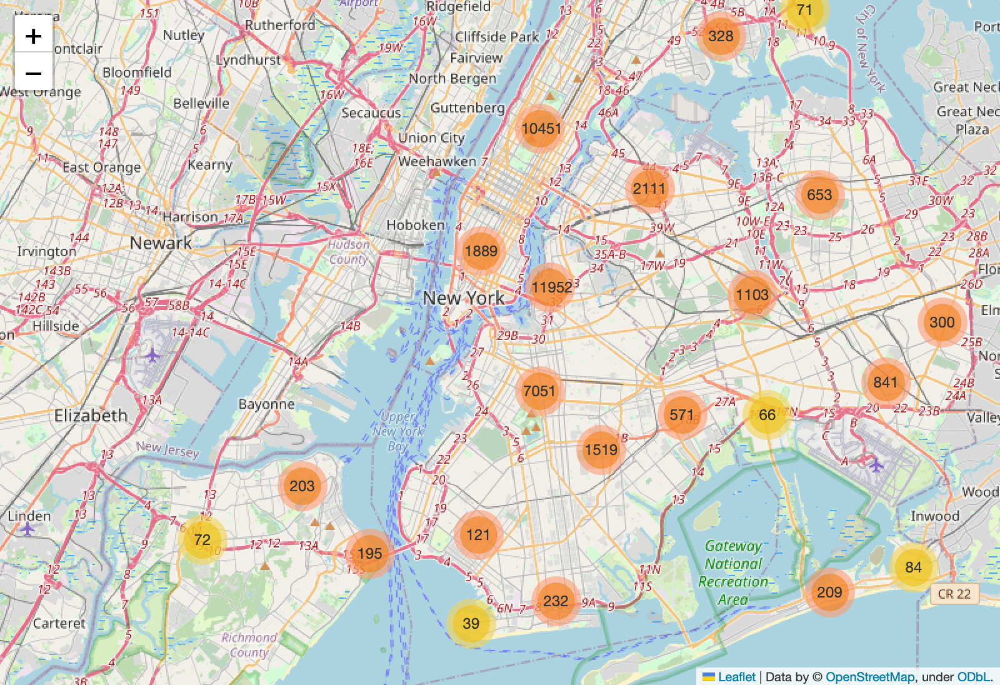

In [16]:

# create a marker cluster object with longitude and latitude
fast_marker_cluster = FastMarkerCluster(listings[['latitude', 'longitude']]).add_to(nyc_map)
nyc_map


convert_map_to_png(nyc_map, 'problem1a')

b) Plot a bar chart of the average price per neighbourhood group. Briefly comment on the relation between the price and neighbourhood group (use your map to analyze it). - (2.5 pts)

<AxesSubplot:xlabel='neighbourhood_group'>

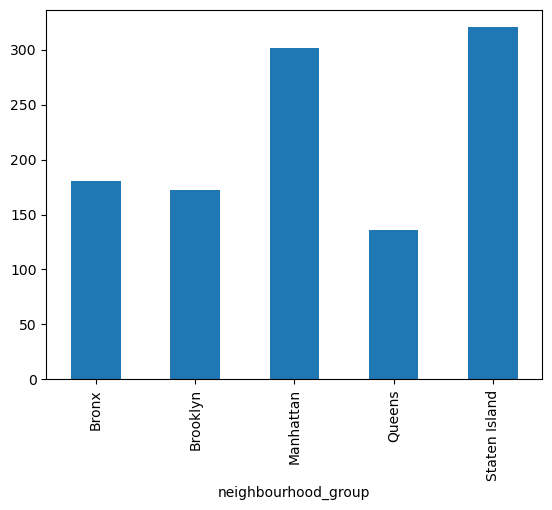

In [18]:
# plot a bar chart of the average price per neighbourhood group
listings.groupby('neighbourhood_group')['price'].mean().plot.bar()


-> Your comments here

Manhattan and Stanten Island are the most expressive ones with an avg price much higher than other areas, while Queens is the cheapest one.

c) You're going to be living in New York City long term so you'd like to find places you can stay that are at minimum 300 days (inclusive). Plot a map that displays all the locations of these places. (Note: some could be in the same location) - (5 pts)


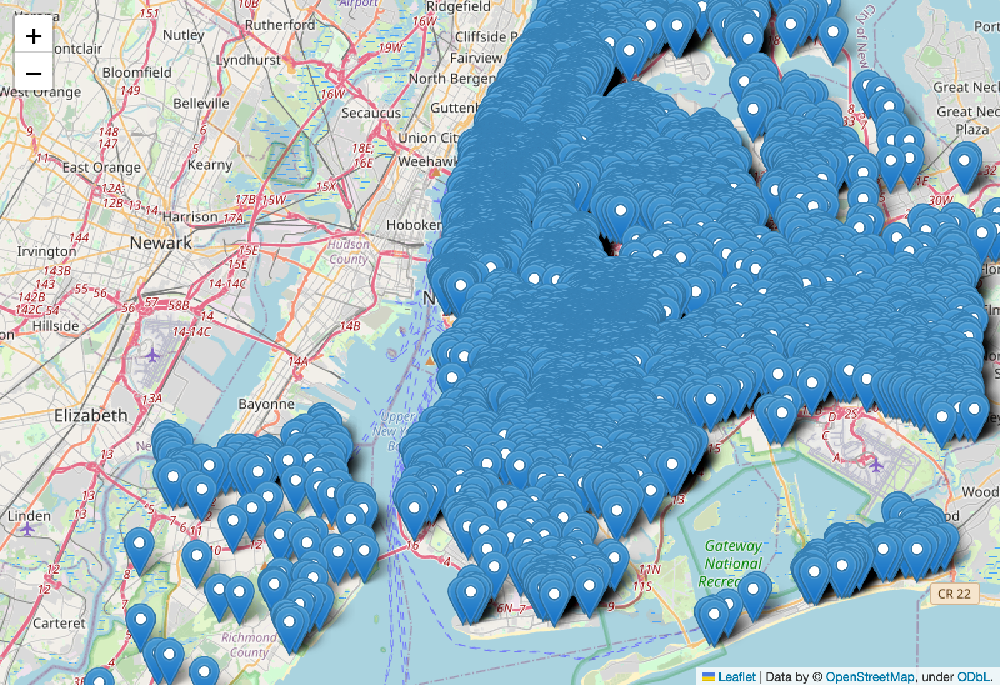

In [7]:
# Write your code below! Leave the instantiated variables: it is for your convenience.
nyc_map_2 = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
# find places that are available 300 daya minimum
listings_300 = listings[listings['availability_365'] >= 300]

# loop through listings_300 and add markers
for i in range(len(listings_300)):
    folium.Marker([listings_300.iloc[i]['latitude'], listings_300.iloc[i]['longitude']]).add_to(nyc_map_2)


convert_map_to_png(nyc_map_2, 'problem1c')

d) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Density-based clustering to create clusters. Plot the points on the NYC map in a color corresponding to their cluster (color could be randomly assigned, but ensure each datapoint is colored to its associated cluster). 
For using `DBSCAN`, have the settings **`eps=0.3, min_samples=10`**. Use a `CircleMarker` with `radius=1`. Plot the clusters on the map and print the number of clusters made. - (15 pts)

Number of clusters: 627
[[ 40.66265    -73.99454      0.        ]
 [ 40.8038     -73.96751     -1.        ]
 [ 40.68535    -73.95512     -1.        ]
 ...
 [ 40.7469017  -73.9782603   -1.        ]
 [ 40.74959584 -73.9807977   -1.        ]
 [ 40.83282398 -73.85237137 123.        ]]


/var/folders/zv/fxtx5svs0f98pyxv2sgl33kw0000gn/T/ipykernel_50723/1378434973.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  listings_dbscan['label'] = labels


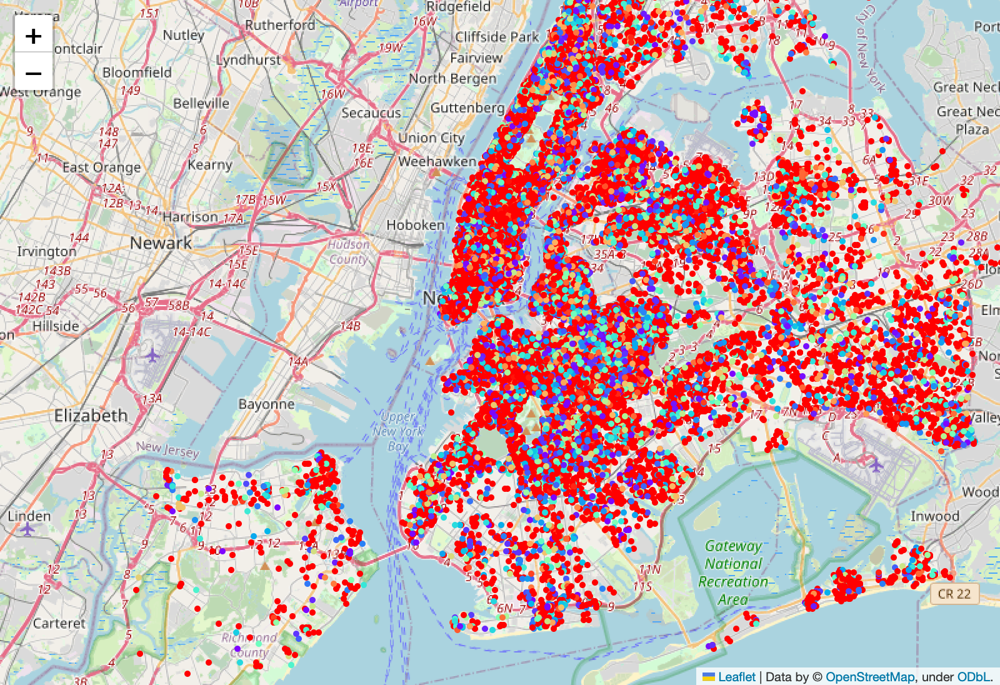

In [16]:
# Write your code below! Leave the instantiated variables: it is for your convenience.
from sklearn.cluster import DBSCAN
import matplotlib.cm as cm
import matplotlib.colors as colors

nyc_map_3 = folium.Map(location=[40.693943, -73.985880], zoom_start=11)
# create dataframe with longitude, latitude, and number_of_reviews
listings_dbscan = listings[['longitude', 'latitude', 'price', 'number_of_reviews']]
# fit dbscan model. epx=0.3, min_samples=10
dbscan = DBSCAN(eps=0.3, min_samples=10).fit(listings_dbscan)
# apply label to every row of listings_dbscan
labels = dbscan.labels_

n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

print(f"Number of clusters: {n_clusters}")

# create a new column in listings_dbscan called 'label'
listings_dbscan['label'] = labels

colors_arr = cm.rainbow(np.linspace(0, 1, n_clusters+1))
rainbow = [colors.rgb2hex(i) for i in colors_arr]

# create a new dataframe with longitude, latitude, and label
listings_for_plot = listings_dbscan[['latitude', 'longitude', 'label']]

print(listings_for_plot.values)

for lat, lon, cluster in listings_for_plot.values:
    folium.CircleMarker(
        [lat, lon],
        radius=1,
        color=rainbow[cluster.astype(int)],
        fill=True,
        fill_color=rainbow[cluster.astype(int)],
        fill_opacity=0.7
    ).add_to(nyc_map_3)


convert_map_to_png(nyc_map_3, 'problem1d')

e) What would happen if you were to increase/decrease `eps`, and what would happen if you were to increase/decrease `min_samples`? Give some examples when running part d (you don't have to give the map image, just say something such as "When testing part d with ... ") - (5 points)

-> Your answer here

* eps is the maximum distance between two samples for one to be considered as in the neighborhood of the other. Increasing the EPS decreases the number of clusters and number of outliers

* min_samples is the number of samples (or total weight) in a neighborhood for a point to be considered as a core point. This includes the point itself. Increasing the min_samples requires more points to form a dense region, which means fewer clusters

* The optimum value of eps and min_samples depends on the actual distribution of data



f) For part d, were the clusters seemed to be scattered or grouped together? Justify your answer. - (2.5 points)

-> Your answer here

The clusters are scattered according to the map generated in part d) because the eps is small and min_samples is large.

g) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. You can use any distance function. Describe your findings. - (10 points)

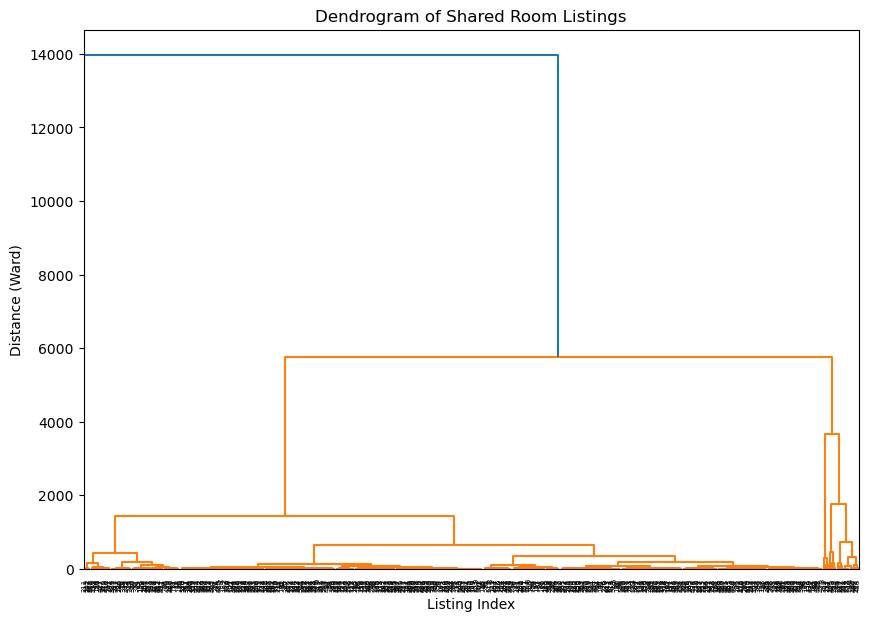

In [18]:
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt


shared_room_df = listings[listings['room_type'] == 'Shared room']
Z = linkage(shared_room_df[['longitude', 'latitude', 'price']], method='ward')

plt.figure(figsize=(10, 7))
dendrogram(Z)
plt.title('Dendrogram of Shared Room Listings')
plt.xlabel('Listing Index')
plt.ylabel('Distance (Ward)')
plt.show()

-> Your comments here

The data belongs to larger groups because the difference between the data points are relatively small.


h) Normalize `longitude`, `latitude`, and `price` by subtracting by the mean (of the column) and dividing by the standard deviation (of the column). Repeat g) using the normalized data. Comment on what you observe. - (5 points)

In [19]:
for column in ['longitude', 'latitude', 'price']:
    mean = shared_room_df[column].mean()
    std = shared_room_df[column].std()
    shared_room_df[column] = (shared_room_df[column] - mean) / std

/var/folders/zv/fxtx5svs0f98pyxv2sgl33kw0000gn/T/ipykernel_50723/2242887494.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shared_room_df[column] = (shared_room_df[column] - mean) / std


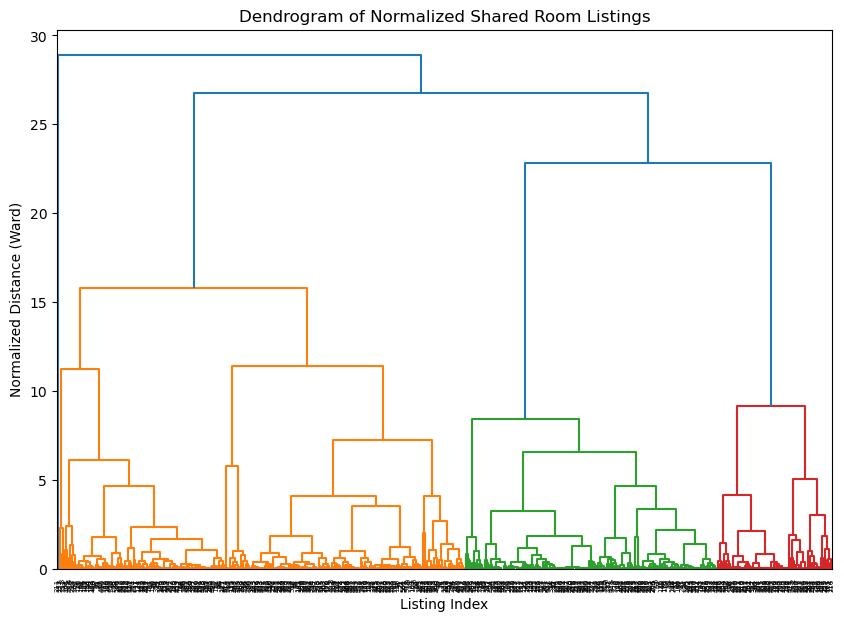

In [20]:
Z_normalized = linkage(shared_room_df[['longitude', 'latitude', 'price']], method='ward')

plt.figure(figsize=(10, 7))
dendrogram(Z_normalized)
plt.title('Dendrogram of Normalized Shared Room Listings')
plt.xlabel('Listing Index')
plt.ylabel('Normalized Distance (Ward)')
plt.show()

-> Your comments here

The data belongs to more groups and the normalized distance distributed more evenly on the dendogram. This is because normalized data ensures that all features have the same scale.

## Exercise 2 (50 points)

a) Fetch the "mnist_784" data and store is as a `.csv` (that way you don't have to fetch it every time - which takes about 30s). (2.5 points)

In [30]:
import matplotlib.pyplot as plt

from sklearn.datasets import fetch_openml

X, y = fetch_openml(name="mnist_784", version=1, return_X_y=True, as_frame=False)

mnist_df = pd.DataFrame(X)
mnist_df['label'] = y

# save mnist_df to mnist_784.csv
mnist_df.to_csv('mnist_784.csv', index=False)
mnist_data = pd.read_csv('mnist_784.csv', header=None)

/Users/jialuli/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3269: DtypeWarning: Columns (784) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


b) Plot the singular value plot for a single example of the 9 digit (2.5 points)

(28, 28)


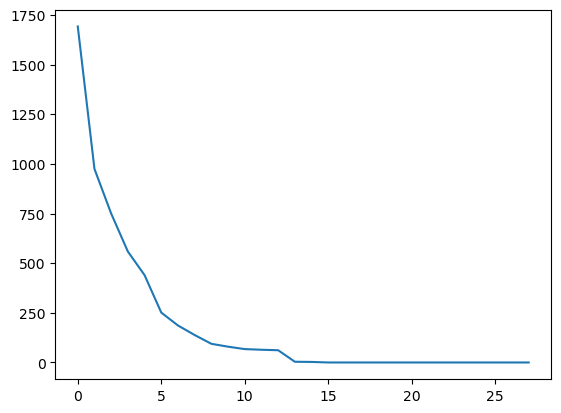

In [94]:
# convert csv to dataframe
digit_9_data = mnist_data[mnist_data[784] == '9'].drop(columns=[784])
example_9 = digit_9_data.iloc[0].to_numpy().reshape(28, 28)
# find the singular value of digit_9 using svd
U, S, V = np.linalg.svd(example_9, full_matrices=False)

# plot the singular values in S
plt.plot(S)

c) Just like we did in class with the image of the boat: By setting some singular values to 0, plot the approximation of an image of a 9 digit next to the original image. (5 points)

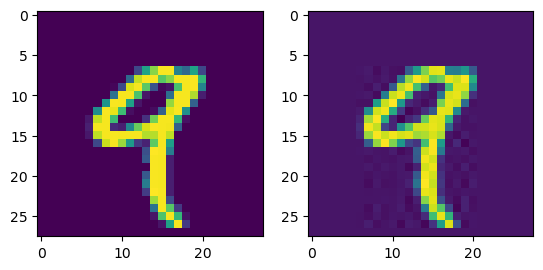

In [80]:
# rank = 10
S_copy = np.copy(S)
S_copy[10:] = 0
# reconstruct digit_9 using U, S, V
original_digit_9 = np.dot(U, np.dot(np.diag(S), V))
reconstructed_digit_9 = np.dot(U, np.dot(np.diag(S_copy), V))

# plot reconstructed_digit_9 and original digit_9
fig, ax = plt.subplots(1, 2)
ax[0].imshow(original_digit_9)
ax[1].imshow(reconstructed_digit_9)


d) Consider the entire dataset as a matrix. Perform SVD and explain why / how you chose a particular rank. Note: you may not be able to run this on the entire dataset in a reasonable amount of time so you may take a small random sample for this and the following questions. (5 points)

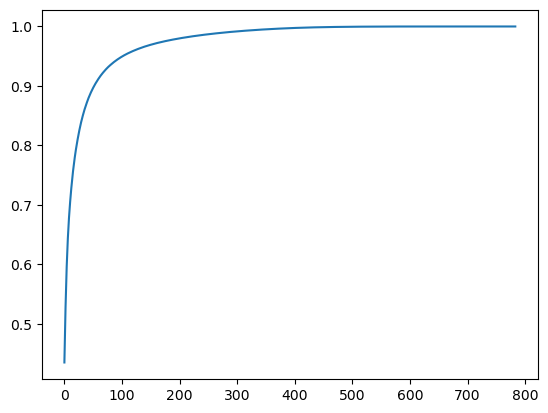

In [97]:
# use the elbow method to plot the svd
U, S, V = np.linalg.svd(mnist_data.drop(columns=[784]), full_matrices=False)

plt.plot(np.cumsum(S**2)/np.sum(S**2))




As we can see the cumulative sum is 90% at around rank 20. Therefore, we can choose rank 20 as a good rank for this dataset.

e) Plot the first 10 singular vectors. Notice that each singular vector's length will be 784 so you can plot them as a 28x28 image. (5points)

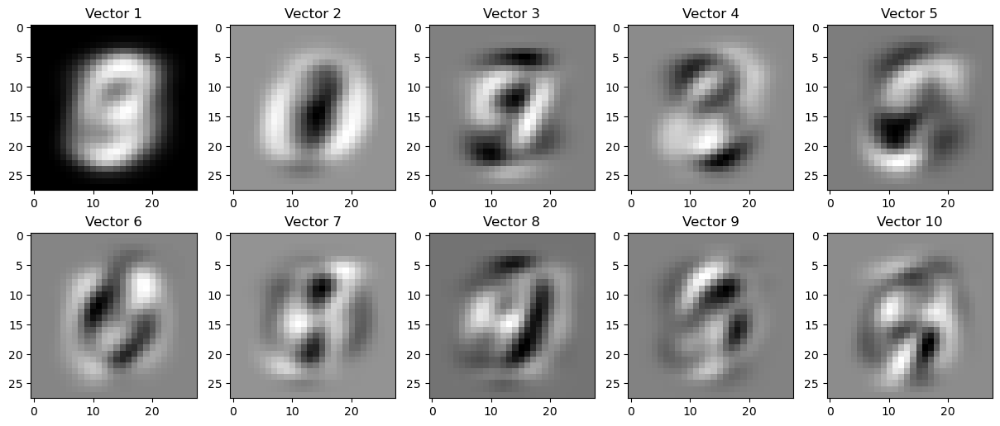

In [99]:
# plot the first 10 singular vectors
fig, axs = plt.subplots(2, 5, figsize=(15, 6))
for i in range(2):
    for j in range(5):
        axs[i, j].imshow(V[i*5+j, :].reshape(28, 28), cmap='gray')
        axs[i, j].set_title(f'Vector {i*5+j+1}')

f) Using Kmeans on this new dataset, cluster the images from d) using 10 clusters and plot the centroid of each cluster. Note: the centroids should be represented as images. (10 points)

In [103]:
# create a new dataset using the first 10 singular vectors
new_data = np.dot(mnist_data.drop(columns=[784]), V[:10, :].T)

# use Kmeans to cluster the new dataset. show the centroid of each cluster
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10).fit(new_data)
kmeans.fit(new_data)

KMeans(n_clusters=10)

(10, 784)


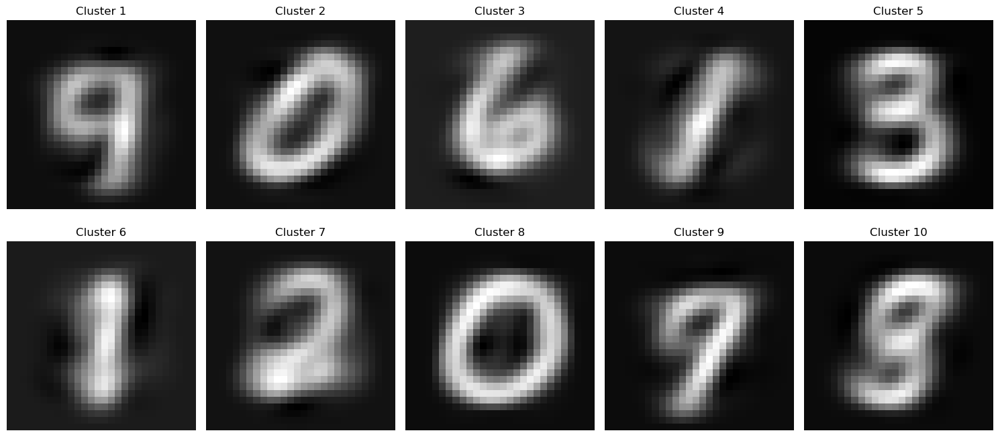

In [107]:
centroids = kmeans.cluster_centers_.dot(V[:10])
print(centroids.shape)

fig, axes = plt.subplots(2, 5, figsize=(15, 7))
axes = axes.ravel()

for i, centroid in enumerate(centroids):
    image = centroid.reshape(28, 28)
    
    axes[i].imshow(image, cmap='gray')
    axes[i].set_title(f"Cluster {i+1}")
    axes[i].axis('off')

plt.tight_layout()
plt.show()


g) Repeat f) on the original dataset (if you used a subset of the dataset, keep using that same subset). Comment on any differences (or lack thereof) you observe between the centroids. (5 points)

In [110]:
original_data = mnist_data.drop(columns=[784])
# use Kmeans to cluster the original dataset. show the centroid of each cluster

kmeans = KMeans(n_clusters=10)
kmeans.fit(original_data)

centroids_original = kmeans.cluster_centers_
print(centroids_original.shape)
y

(10, 784)


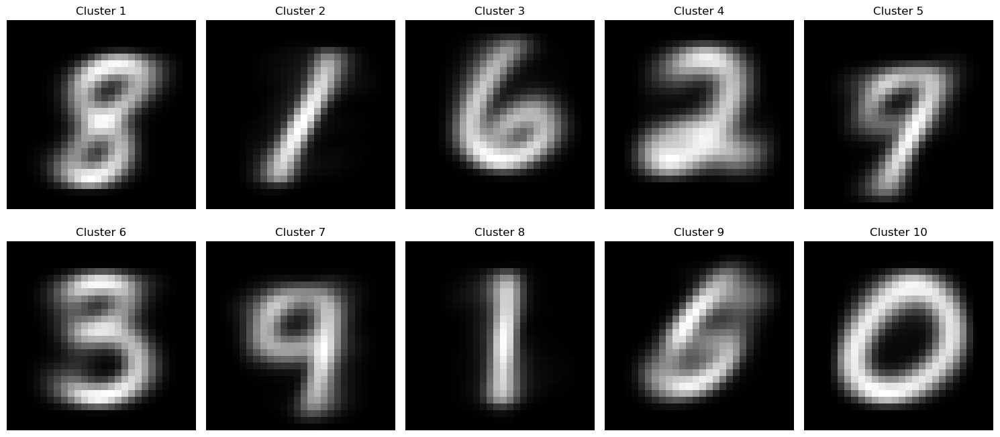

In [113]:
fig, axes = plt.subplots(2, 5, figsize=(15, 7))
axes = axes.ravel()

for i, centroid in enumerate(centroids_original):
    
    image = centroid.reshape(28, 28)
    axes[i].imshow(image, cmap='gray')
    axes[i].set_title(f"Cluster {i+1}")
    axes[i].axis('off')

plt.tight_layout()
plt.show()

The full rank images are clearer than the rank 10 images

h) Create a matrix (let's call it `O`) that is the difference between the original dataset and the rank-10 approximation of the dataset. (5 points)

In [114]:
U_10 = U[:, :10]
S_10 = np.diag(S[:10])
V_10 = V[:10, :]

rank_10_approx = np.dot(U_10, np.dot(S_10, V_10))

O = original_data - rank_10_approx

i) The largest (using euclidean distance from the origin) rows of the matrix `O` could be considered anomalous data points. Briefly explain why. Plot the 10 images responsible for the 10 largest rows of that matrix `O`. (10 points)

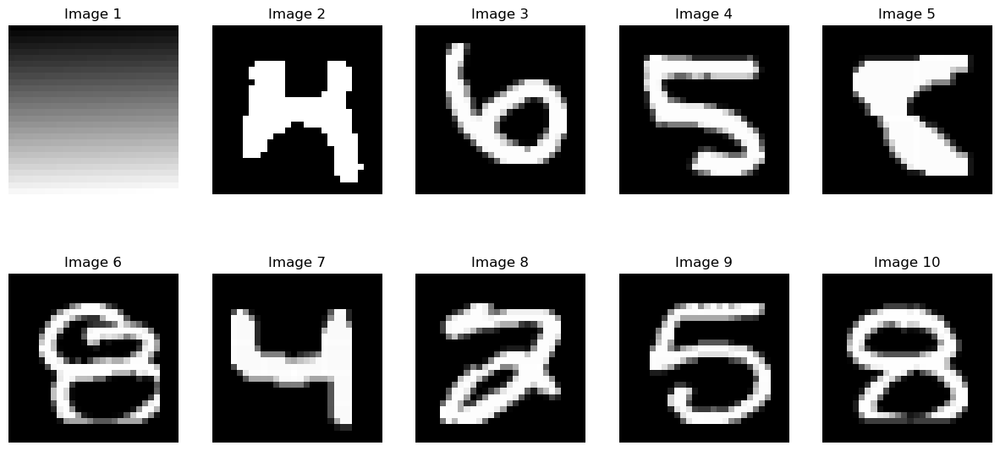

In [115]:
norms = np.linalg.norm(O, axis=1)
norms_sorted = np.argsort(norms)[::-1]
top_k_indices = norms_sorted[:10]

fig, axes = plt.subplots(2, 5, figsize=(15, 7))
axes = axes.ravel()

for i, index in enumerate(top_k_indices):
        image = original_data.iloc[index].to_numpy().reshape(28, 28)
        axes[i].imshow(image, cmap='gray')
        axes[i].set_title(f"Image {i+1}")
        axes[i].axis('off')

Since the largest eculidian rows of O are the ones that are the most different from the original dataset, they are the most anomalous data points.

## Bonus (20pts)

Re-using the dbscan code written in class, reproduce the following animation of the dbscan algorithm

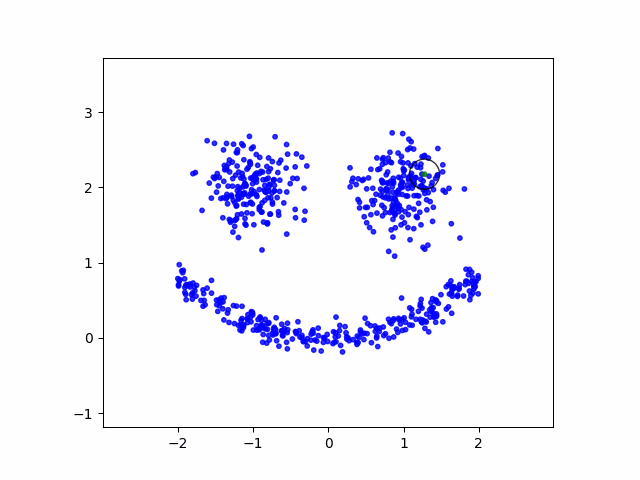

In [116]:
from IPython.display import Image
Image(filename="dbscan.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs



In [ ]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

TEMPFILE = 'temp.png'

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts 
        self.epsilon = epsilon
        self.snaps = []


    def snapshot(self):
        fig, ax = plt.subplots()
        # set the colors for the clusters
        colors = [...]

        ax.scatter(..., c=colors, s=10)
        # create circle around the point assigned to a cluster
        cir = plt.Circle(...) 
        ax.add_patch(cir)
        ax.set_xlim(...)
        ax.set_ylim(...)
        ax.set_aspect('equal') # necessary or else the circles appear to be oval shaped

        fig.savefig(TEMPFILE)
        plt.close()

        return im.fromarray(np.asarray(im.open(TEMPFILE)))


    def dbscan(self):
        # implement the body of dbscan function
        
        # use snapshot() to save the image of each iteration
        # return the clustering result

        # return the clustering result

        ...
        return

    def get_neighbors(self, point):
        # implement the body of get_neighbors function
        neighbors = []
        for i in

        return

centers = [...]
eyes, _ = datasets.make_blobs(...)

mouth_x = ... * np.random.random(...)
mouth_y = ... + .1 * np.random.randn(...)

face = np.append(eyes, ..., axis=0)

dbc = DBC(face, ..., ...)
clustering = dbc.dbscan()

dbc.snaps[0].save(
    'dbscan.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)

In [118]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets
from sklearn.metrics.pairwise import euclidean_distances

TEMPFILE = 'temp.png'

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.snaps = []
        self.clusters = [-1] * len(dataset)  # -1 indicates noise or unassigned point

    def region_query(self, point_idx):
        return np.where(euclidean_distances([self.dataset[point_idx]], self.dataset)[0] <= self.epsilon)[0]

    def snapshot(self, point_idx, cluster_id):
        fig, ax = plt.subplots()
        colors = [cluster if cluster != -1 else len(self.dataset) for cluster in self.clusters]

        ax.scatter(self.dataset[:, 0], self.dataset[:, 1], c=colors, s=10, cmap='rainbow')
        cir = plt.Circle((self.dataset[point_idx, 0], self.dataset[point_idx, 1]), self.epsilon, color='black', fill=False)
        ax.add_patch(cir)
        ax.set_xlim(self.dataset[:, 0].min() - 1, self.dataset[:, 0].max() + 1)
        ax.set_ylim(self.dataset[:, 1].min() - 1, self.dataset[:, 1].max() + 1)
        ax.set_aspect('equal')

        fig.savefig(TEMPFILE)
        plt.close()

        self.snaps.append(im.fromarray(np.asarray(im.open(TEMPFILE))))

    def dbscan(self):
        cluster_id = 0

        for point_idx, point in enumerate(self.dataset):
            if self.clusters[point_idx] != -1:  # already assigned
                continue

            neighbors = self.region_query(point_idx)

            if len(neighbors) < self.min_pts:
                self.snapshot(point_idx, cluster_id)
                continue

            self.clusters[point_idx] = cluster_id
            self.snapshot(point_idx, cluster_id)

            for neighbor in neighbors:
                if self.clusters[neighbor] == -1:  # not yet assigned
                    self.clusters[neighbor] = cluster_id
                    self.snapshot(neighbor, cluster_id)

                    deep_neighbors = self.region_query(neighbor)
                    if len(deep_neighbors) >= self.min_pts:
                        neighbors = np.concatenate([neighbors, deep_neighbors])

            cluster_id += 1


centers = [[-1, 0], [1, 0]]
eyes, _ = datasets.make_blobs(n_samples=100, centers=centers, cluster_std=0.3)

mouth_x = np.linspace(-1.5, 1.5, 200)
mouth_y = -1.5 - 0.2 * mouth_x**2 + 0.1 * np.random.randn(200)

face = np.append(eyes, list(zip(mouth_x, mouth_y)), axis=0)

dbc = DBC(face, 5, 0.3)
dbc.dbscan()

dbc.snaps[0].save(
    'dbscan.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)

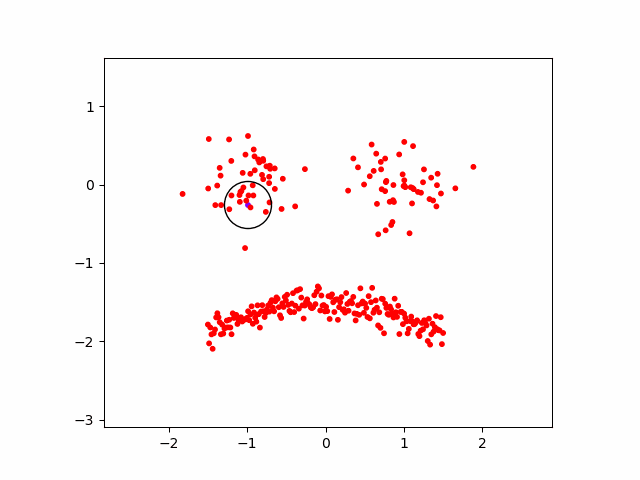

In [119]:
Image(filename="dbscan.gif", width=500, height=500)